# Проект. Исследование рынка заведений общественного питания Москвы.

**ОПИСАНИЕ ПРОЕКТА**: Инвесторы из фонда «Shut Up and Take My Money» решили попробовать себя в новой области и открыть заведение общественного питания в Москве. Заказчики ещё не знают, что это будет за место: кафе, ресторан, пиццерия, паб или бар, — и какими будут расположение, меню и цены.

**Для анализа предоставлены следующие данные:**
* название заведения
* адрес заведения
* категория заведения, например «кафе», «пиццерия» или «кофейня»
* информация о днях и часах работы
* широта географической точки, в которой находится заведение
* долгота географической точки, в которой находится заведение
* рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0)
* категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее
* строка, которая хранит среднюю стоимость заказа в виде диапазона
* число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»
* число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»
* число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки)
* административный район, в котором находится заведение, например Центральный административный округ
* количество посадочных мест

**Цели исследования:**
* Изучить предоставленные данные, проверить корректность данных, провести предобработку данных для анализа
* Провести исследовательский анализ данных, выявить общие паттерны и закономерности
* Провести детальное исследование по категории "Кофейни"
* Определить предпочтения пользователей в различных округах Москвы 
* Определить взаимосвязь среднего чека и рейтинга заведения 
* Выявить наиболее популярные места размещения заведений
* Подготовить презентацию для заказачика

  **Ход исследования**:
  * Изучение данных
  * Предобработка данных
  * Исследовательский анализ данных:
     * Общий анализ:
       * какие категории заведений общественного питания представлены в Москве, какие заведения  чаще ищут в интернете
       * сколько заведений каждой категории в Москве, сколько в среднем гостей они могут принять
       * как соотносятся сетевые и несетевые заведения,какие их доли в категориях? Какие сети самые крупные
       * какое количество заведений в разных районах Москвы, какие категории преобладают, на каких улицах больше всего заведений
       * различается ли рейтинг заведений, в зависимости от района Москвы
       * различается ли средний чек, в зависимости от района Москвы
       * взаимосвязаны ли рейтинг и  средний чек, отличается ли эта связь в разных категориях
     * Детальный анализ категории "Кофейни":
       * в каком районе больше всего кофеен, на каких улицах, рядом с какими метро
       * какие факторы влияют на рейтинг заведения, как влияют
       * сколько гостей могут принять в среднем сетевые и несетевые заведения, каков средний чек и рейтинг в самых крупных сетях
       * различаются ли рейтинг и средняя цена чашки кофе в зависимости от района Москвы
       * каких кофеен больше, сетевых или несетевых, сколько мест в сетевых и несетевых кофейнях
       * как еще соотносится расположение сетевых и несетевых кофеен
  * Формулирование общего вывода по исследованию
  * Подготовка презентации

## Предобработка данных.

### Загрузим необходимые библиотеки и получим данные:

In [1]:
import pandas as pd
import datetime as dt
import numpy as np
import matplotlib.pyplot as plt
from pandas.plotting import register_matplotlib_converters
import scipy.stats as st
import seaborn as sns
from plotly import graph_objects as go
import plotly.express as px
from numpy import median
import folium
from folium import Marker, Map
from folium.plugins import MarkerCluster
from folium import Map, Choropleth
from folium.features import CustomIcon
import requests
import json
from math import radians, cos, sin, asin

In [2]:
try:
    data = pd.read_csv('/Users/aleksandrstrokov/Downloads/moscow_places.csv')
except:
    data = pd.read_csv('https://code.s3.yandex.net/datasets/moscow_places.csv')

In [3]:
pd.set_option('display.max_columns', None)

In [4]:
data.head(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


### Проверим данные и проведем их обработку

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


*изменим тип данных с числового на бубелевый в колонке chain:*

In [6]:
data['chain'] = data['chain'].astype('bool')

*посмотрим на пропуски*

In [7]:
data.isna().sum()

name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                3611
dtype: int64

*видим, что данные не полные и есть много пропусков. У нас не достаточно данных, чтобы их качественно заполнить, поэтому оставим данные как есть*

*Проверим таблицу на полные дубликаты строк:*

In [8]:
data.duplicated().sum()

0

*Полных дубликатов не обнаружено*

*Посмотрим на столбец с адрессом, какие уеникальные значения в нём есть, нет ли скрытых дубликатов*

In [9]:
for x in data['address'].unique():
    print(x)

Москва, улица Дыбенко, 7/1
Москва, улица Дыбенко, 36, корп. 1
Москва, Клязьминская улица, 15
Москва, улица Маршала Федоренко, 12
Москва, Правобережная улица, 1Б
Москва, Ижорская улица, вл8Б
Москва, Клязьминская улица, 9, стр. 3
Москва, Дмитровское шоссе, 107, корп. 4
Москва, Ангарская улица, 39
Москва, Левобережная улица, 12
Москва, улица Маршала Федоренко, 10с1
Москва, МКАД, 80-й километр, 1
Москва, Базовская улица, 15, корп. 1
Москва, Ангарская улица, 42с1
Москва, улица Бусиновская Горка, 2
Москва, Базовская улица, 15, корп. 8
Москва, Ленинградское шоссе, 71Б, стр. 2
Москва, Коровинское шоссе, 30А
Москва, Ижорский проезд, 5
Москва, Прибрежный проезд, 7
Москва, Коровинское шоссе, 35, стр. 17
Москва, Лобненская улица, 13к2
Москва, улица Дыбенко, 9Ас1
Москва, парк Левобережный
Москва, Дмитровское шоссе, 107к2
Москва, улица Дыбенко, 7, стр. 1
Москва, МКАД, 78-й километр, 14к1
Москва, Дмитровское шоссе, 157, стр. 15
Москва, Базовская улица, 15, корп. 6
Москва, Коровинское шоссе, 23, корп.

*Данные в порядке, выделим из адреса улицу и создадим новый столбец с названием улиц:*

In [10]:
data[['a','street', 'c']] = data['address'].str.split(',', n=2, expand=True)
data = data.drop(['a','c'], axis=1)
data['street'] = data['street'].str.replace(' улица', '')
data['street'] = data['street'].str.replace('улица ', '')

In [11]:
data.head(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,False,NaN,Дыбенко
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,False,4.0,Дыбенко
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,False,45.0,Клязьминская
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,False,NaN,Маршала Федоренко
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,True,148.0,Правобережная


*Посмотрим на столбец с режимом работы заведений:*

In [12]:
for x in data['hours'].unique():
    print(x)

ежедневно, 10:00–22:00
пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00
ежедневно, 09:00–22:00
ежедневно, 10:00–23:00
пн 15:00–04:00; вт-вс 15:00–05:00
пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00–22:00
ежедневно, 12:00–00:00
ежедневно, круглосуточно
ежедневно, 10:00–21:00
вт-сб 09:00–18:00
ежедневно, 08:00–22:00
ежедневно, 13:00–00:00
пн-пт 08:30–18:30; сб 10:00–20:00
ежедневно, 09:00–21:00
пн-пт 09:00–21:00
пн-чт 11:00–22:00; пт,сб 11:00–23:00; вс 11:00–22:00
пн-пт 08:00–22:00; сб,вс 10:00–22:00
ежедневно, 10:00–19:00
пн-пт 09:00–16:00
ежедневно, 08:00–21:00
ежедневно, 09:00–23:00
ежедневно, 08:00–23:00
nan
пн-пт 08:00–18:00
пн-пт 09:00–19:00
ежедневно, 11:00–00:00
ежедневно, 09:00–02:00
ежедневно, 12:00–23:00
ежедневно, 12:00–03:00
ежедневно, 16:00–06:00
пн-чт 12:30–00:00; пт,сб 12:30–02:00; вс 12:30–00:00
пн-сб 11:00–23:00; вс 12:00–23:00
пн-пт 08:00–19:00
пн-пт 11:00–22:00; сб,вс 11:00–23:00
пн-чт 12:00–23:00; пт,сб 12:00–00:00; вс 12:00–23:00
ежедневно, 09:00–01:00
ежедневн

*Выделим заведения с ежедневным, круглосуточным режимом работы, и запишем эти данные в новый столбец:*

In [13]:
def categorize(row):
    try:
        if 'ежедневно, круглосуточно' in row:
            return True
        else:
            return False
    except:
        pass

In [14]:
data['is_24/7'] = data['hours'].apply(categorize)

In [15]:
data[data['is_24/7'] == True].head(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
10,Great Room Bar,"бар,паб","Москва, Левобережная улица, 12",Северный административный округ,"ежедневно, круглосуточно",55.877832,37.469171,4.5,средние,Цена бокала пива:250–350 ₽,NaN,NaN,False,102.0,Левобережная,True
17,Чайхана Беш-Бармак,ресторан,"Москва, Ленинградское шоссе, 71Б, стр. 2",Северный административный округ,"ежедневно, круглосуточно",55.876908,37.449876,4.4,средние,Средний счёт:350–500 ₽,425.0,NaN,False,96.0,Ленинградское шоссе,True
19,Пекарня,булочная,"Москва, Ижорский проезд, 5",Северный административный округ,"ежедневно, круглосуточно",55.887969,37.515688,4.4,NaN,NaN,NaN,NaN,True,NaN,Ижорский проезд,True
24,Drive Café,кафе,"Москва, улица Дыбенко, 9Ас1",Северный административный округ,"ежедневно, круглосуточно",55.879992,37.481571,4.0,NaN,NaN,NaN,NaN,True,NaN,Дыбенко,True
49,2U-Ту-Ю,пиццерия,"Москва, Ижорская улица, 8А",Северный административный округ,"ежедневно, круглосуточно",55.886160,37.508784,2.7,NaN,Средний счёт:900 ₽,900.0,NaN,False,NaN,Ижорская,True


*Для визуализации будет лучше, если категории будут указаны с большой буквы. Изменим это в столбце category:*

In [16]:
data['category'] = data['category'].str.capitalize()

*Проверим также данные на неявные дубликаты:*

In [17]:
for column in data:
    print(column, ':', data.duplicated(subset=column).sum())

name : 2792
category : 8398
address : 2653
district : 8397
hours : 7098
lat : 197
lng : 148
rating : 8365
price : 8401
avg_bill : 7508
middle_avg_bill : 8175
middle_coffee_cup : 8309
chain : 8404
seats : 8176
street : 6958
is_24/7 : 8403


*Видим, что дубликаты есть во всех столбцах. Но нас в первую очередь интересуют дубликаты в координатах, так как такого не должно быть. Проверим, не ли полностью дублированных столбцов с координатами:*

In [18]:
data[['lat', 'lng']].duplicated().sum()

34

*Есть 34 полных дубликата, удалим их:*

In [19]:
data = data[~data[['lat', 'lng']].duplicated()]

In [20]:
data[['lat', 'lng']].duplicated().sum()

0

*Теперь у нас нет заведений с одинаковыми координатами. Проверим еще, что за одинакове адреса*

In [21]:
data[data['address'].duplicated()].sort_values(by='address')

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
1311,Prime,Ресторан,"Москва, 1-й Волоколамский проезд, 10, стр. 1",Северо-Западный административный округ,пн-пт 08:00–19:00,55.804294,37.490584,4.0,низкие,Средний счёт:400–600 ₽,500.0,NaN,True,100.0,1-й Волоколамский проезд,False
4298,Catcher,Кафе,"Москва, 1-й Красногвардейский проезд, 19",Центральный административный округ,"ежедневно, 10:00–21:30",55.749773,37.535611,4.3,NaN,NaN,NaN,NaN,False,NaN,1-й Красногвардейский проезд,False
4251,Hudson Deli,Кафе,"Москва, 1-й Красногвардейский проезд, 21с2",Центральный административный округ,пн-пт 08:00–20:00,55.749495,37.533647,4.2,средние,Средний счёт:500–1000 ₽,750.0,NaN,False,NaN,1-й Красногвардейский проезд,False
8217,КофеГУСЬ,Кофейня,"Москва, 1-й Нагатинский проезд, 11, корп. 1",Южный административный округ,"пн-пт 08:00–21:00; сб,вс 09:00–21:00",55.678660,37.634674,4.2,NaN,Цена чашки капучино:150–200 ₽,NaN,175.0,False,100.0,1-й Нагатинский проезд,False
8163,Рикису,Кафе,"Москва, 1-й Нагатинский проезд, 11, корп. 2",Южный административный округ,"ежедневно, 11:00–23:00",55.677413,37.634570,4.9,NaN,NaN,NaN,NaN,False,20.0,1-й Нагатинский проезд,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5600,Яркофе,Кафе,"Москва, шоссе Энтузиастов, 22/18",Юго-Восточный административный округ,"ежедневно, 07:00–21:00",55.751152,37.716711,4.4,NaN,NaN,NaN,NaN,False,90.0,шоссе Энтузиастов,False
5541,Кафе Пир Ок,Кафе,"Москва, шоссе Энтузиастов, 31",Восточный административный округ,NaN,55.758560,37.749589,4.2,NaN,NaN,NaN,NaN,False,70.0,шоссе Энтузиастов,None
5531,Burger Club,Ресторан,"Москва, шоссе Энтузиастов, 31",Восточный административный округ,"пн-пт 08:00–23:00; сб,вс 10:00–22:00",55.758614,37.751318,4.0,NaN,Средний счёт:250–500 ₽,375.0,NaN,True,70.0,шоссе Энтузиастов,False
5579,Пиццерия,Пиццерия,"Москва, шоссе Энтузиастов, 53",Восточный административный округ,NaN,55.773138,37.824711,4.2,NaN,NaN,NaN,NaN,False,45.0,шоссе Энтузиастов,None


*По  одному адресу может располагаться несколько заведений, оставим без изменений.*

*Проверим также, не дублируются ли категории заведений.*

In [22]:
df = data.pivot_table(index='name', columns='category', values='rating', aggfunc='nunique').reset_index()
df['count']= df.count(numeric_only=True,axis=1)
df = df.query('count > 1').sort_values(by='count', ascending=False)
df

category,name,"Бар,паб",Булочная,Быстрое питание,Кафе,Кофейня,Пиццерия,Ресторан,Столовая,count
3691,Му-Му,1.0,NaN,1.0,4.0,2.0,1.0,2.0,1.0,7
2882,Кафе,2.0,NaN,5.0,27.0,5.0,1.0,5.0,6.0,7
5064,Хинкальная,3.0,NaN,5.0,10.0,NaN,NaN,7.0,1.0,5
2444,Грузинская кухня,NaN,1.0,1.0,1.0,NaN,NaN,4.0,NaN,4
2019,Бистро,1.0,1.0,3.0,4.0,NaN,NaN,NaN,NaN,4
...,...,...,...,...,...,...,...,...,...,...
2240,Вкус востока,NaN,NaN,1.0,1.0,NaN,NaN,NaN,NaN,2
2238,Вкус Индии,NaN,NaN,NaN,1.0,NaN,NaN,2.0,NaN,2
2208,Виктория,NaN,NaN,NaN,3.0,NaN,NaN,NaN,1.0,2
2193,Верона,NaN,NaN,NaN,1.0,NaN,NaN,1.0,NaN,2


*Видим, что некоторые заведения дублируются сразу в нескольких категориях. Попробуем это исправить:*

In [23]:
data = data.sort_values(by=['name', 'category'])
data['cat_count'] = data.groupby(['name','category']).category.transform('count')
data = data.sort_values(by=['name', 'cat_count'], ascending=[True, False])
data['new_category'] = data.groupby('name').category.transform('first')
data['category'] = data['new_category']

*Итак, в новом столбце мы присвоили всем заведениям одну категорию, исходя из того, какая категория чаще присваивается в сети заведений(при рочих равных, присвоили ту, что присвоилась первой). Проверим, есть ли в новом столбце дублирующие категории:* 

In [24]:
df_1 = data.pivot_table(index='name', columns='category', values='rating', aggfunc='nunique').reset_index()
df_1['count']= df_1.count(numeric_only=True,axis=1)
df_1 = df_1.query('count > 1').sort_values(by='count', ascending=False)
df_1

category,name,"Бар,паб",Булочная,Быстрое питание,Кафе,Кофейня,Пиццерия,Ресторан,Столовая,count


*Теперь дублей нет.*

**Шаг предобработки данных завершён, можем приступать к анализу.**

## Анализ заведений общественного питания по категориям.

*Посмотрим на распределение цифровых величин:*

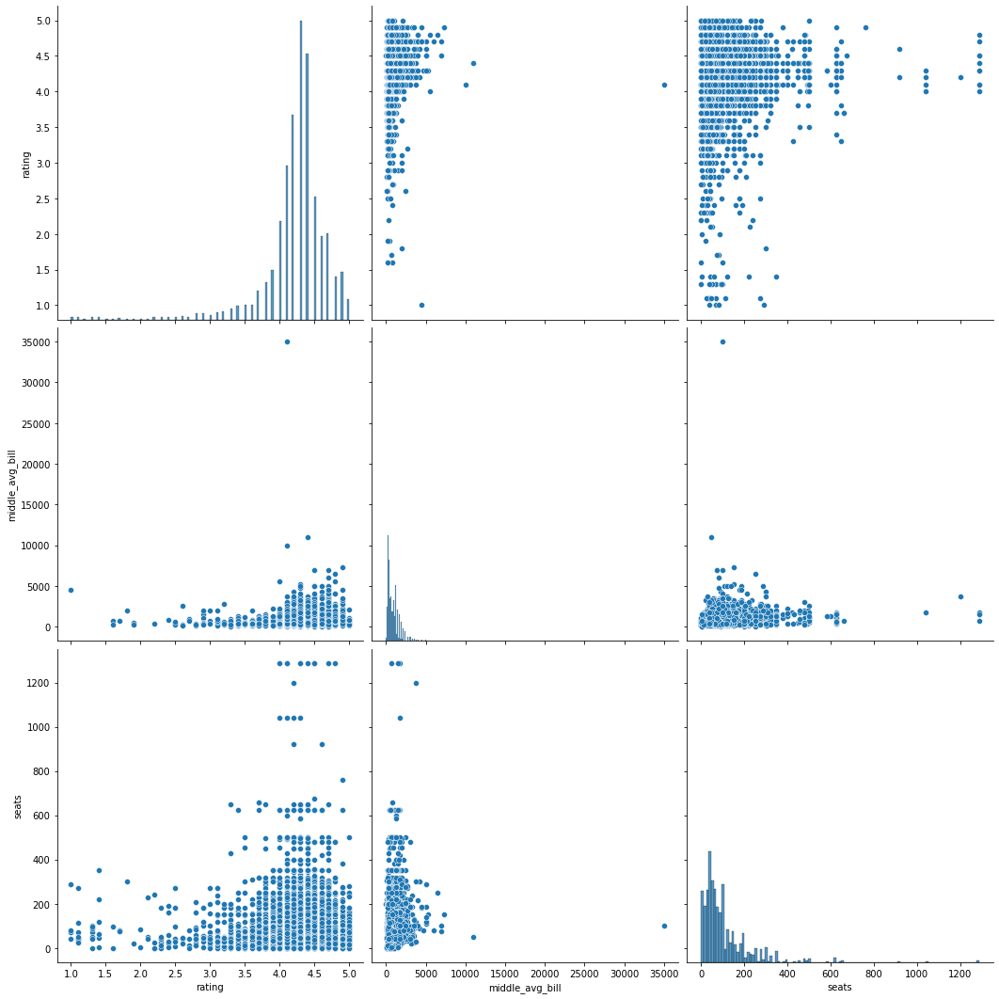

In [25]:
sns.pairplot(data, vars=['rating', 'middle_avg_bill', 'seats'], height=5);

**Распределение всех величин далеко от нормального, поэтому в качестве среднего будем брать медианное значение.**

### Количество заведений в категориях:

*Сгруппируем данные и посмотрим, солько заведений в каждой категории:*

In [26]:
category = data.groupby('category').agg({'name': 'count'}).sort_values(by='name', ascending=False).reset_index()
category.sort_values(by='name', ascending=False)

,category,name
0,Кафе,2530
1,Ресторан,1862
2,Кофейня,1373
3,"Бар,паб",804
4,Пиццерия,622
5,Быстрое питание,611
6,Столовая,287
7,Булочная,283


*Построим  диаграмму, чтобы оценить долю заведений каждой категории от общего количества заведений в Москве:*

In [27]:
fig = px.bar(category, x='category', y='name', color='category', text='name',color_discrete_sequence=px.colors.qualitative.Set3)
fig.update_layout(title="Доля заведений каждой категории от общего количества заведений", title_x=0.5)
fig.update_layout(showlegend=False)
fig.update_layout(template='plotly_white')
fig.update_layout(xaxis_title='Категория', yaxis_title='Количество заведений')
fig.show() 

**Отмечаем, чтол больше всего в Москве Кафе, а меньше всего булочных.**

### Количество запросов в интернете с поиском категории заведений.

*В ручную создадим датафрейм с иформацией о запросах (Источник: Яндекс. Подбор слов):*

In [28]:
stat = {'category': ['Кафе', 'Ресторан', 'Кофейня', 'Столовая', 'Булочная', 'Быстрое питание', 'Пиццерия','Бар,Паб'],'requests': [1209802, 2301888 , 100791, 239401, 11164, 14851, 46623, 668370]} 
stat = pd.DataFrame(stat)
stat['popularity'] = [112,207,126, 89, 95, 108, 93,133]
stat = stat.sort_values(by='popularity', ascending=False).rename(columns={'popularity':'Популярность', 'requests':'Количество запросов'})
stat

,category,Количество запросов,Популярность
1,Ресторан,2301888,207
7,"Бар,Паб",668370,133
2,Кофейня,100791,126
0,Кафе,1209802,112
5,Быстрое питание,14851,108
4,Булочная,11164,95
6,Пиццерия,46623,93
3,Столовая,239401,89


<div class="alert alert-block alert-danger">✍
    

__Комментарий от ревьюера №1__

Вручную подставляешь данные
</div>

<div class="alert alert-info"> <b>Комментарии студента:</b> У нас не было темы запросов и парсинга в основном курсе. Я пытался, но так и  не понял , как мне их получить через запрос с Яндекс "подбор слов", оставил до научиться, когда время появится. Так нельзя оставить? Ведь этого не было в задании

*Построим столбчатую диаграмму по популярности запросов в городе Москва. В качестве цветового индикатора добавим количество запросов:*

In [29]:
fig = px.bar(stat, x='category', y='Популярность', color='Количество запросов', color_continuous_scale=px.colors.sequential.Blues)
fig.update_layout(showlegend=False)
fig.update_layout(template='plotly_white')
fig.update_layout(xaxis_title="Категория", yaxis_title="Популярность в регионе, в %")
fig.show() 

**Видим, что по количеству запросов и популярности лидируют рестораны. Отстают быстрое питание и булочная.**

### Сколько гостей в среднем может принять заведение каждой категории

*Сгруппируем данные и посмотрим, каково медманное количество заведений в каждой категории:*

In [30]:
seats = data.groupby('category').agg({'seats': 'median'}).reset_index().sort_values(by='seats', ascending=False)
seats

,category,seats
6,Ресторан,89.0
0,"Бар,паб",83.5
4,Кофейня,80.0
7,Столовая,75.0
2,Быстрое питание,62.0
3,Кафе,60.0
5,Пиццерия,55.0
1,Булочная,49.0


*Построим круговую диаграмму распределения количества мест:*

In [31]:
fig = px.bar(seats, x='category', y='seats', color='category', text='seats',color_discrete_sequence=px.colors.qualitative.Set3)
fig.update_layout(title="Среднее количество мест по категориям заведений", title_x=0.5)
fig.update_layout(showlegend=False)
fig.update_layout(template='plotly_white')
fig.update_layout(xaxis_title='Категория', yaxis_title='Количество мест')
fig.show() 

**Видим, что в среднем больше всего  гостей принимают рестораны. Меньше всего булочные и пиццерии, но это может быть связано с тем, что там часто берут еду на вынос.** 

### Сколько сетевых и несетевых заведений и какова их доля в каждой категории.

*Сгруппируем данные и посмотрим на количество заведений с признаками "сеть" и "не сеть":*

In [32]:
chains = data.groupby('chain').agg({'name': 'count'}).reset_index()
chains

,chain,name
0,False,5180
1,True,3192


*Построим круговую диаграмму:*

In [33]:
fig = go.Figure(data=[go.Pie(labels=['Несетевые','Сетевые'], values=['5201','3205'], textinfo='value+label+percent', pull=[0.1, 0])])
fig.update_layout(title="Сетевые и несетевые заведения", title_x=0.5)
fig.update_layout(
    autosize=False,
    width=900,
    height=900)
fig.update_layout(showlegend=False)
fig.update_traces(marker=dict(colors=['e63946','1d3557']))
fig.show()

**Видим, что несетевых заведений в Москве больше.**

*Посмотрим, какакова доля сетевых заведений в  разрезе категорий:*

In [34]:
chains = data.pivot_table(index=['chain', 'category'], values='name', aggfunc='count').reset_index()
chains.loc[chains["chain"] == True,  "chain"] = 'Сетевые'
chains.loc[chains["chain"] == False,  "chain"] = 'Несетевые'
chains.sort_values(by=['chain', 'name'])
chains['sum'] = chains.groupby('chain').name.transform(sum)
chains['rate'] = round((chains['name']/chains['sum'])*100)
chains['rate'] = chains['rate'].astype(int).astype(str) + "%"
chains.columns = ['Признак сети', 'Категория', 'Количество заведений по категории', 'Количество заведений по признаку','Доля категории']
chains = chains.sort_values(by ='Количество заведений по категории', ascending= False)
chains

,Признак сети,Категория,Количество заведений по категории,Количество заведений по признаку,Доля категории
3,Несетевые,Кафе,1608,5180,31%
6,Несетевые,Ресторан,1299,5180,25%
11,Сетевые,Кафе,922,3192,29%
4,Несетевые,Кофейня,690,5180,13%
12,Сетевые,Кофейня,683,3192,21%
0,Несетевые,"Бар,паб",592,5180,11%
14,Сетевые,Ресторан,563,3192,18%
2,Несетевые,Быстрое питание,368,5180,7%
13,Сетевые,Пиццерия,325,3192,10%
5,Несетевые,Пиццерия,297,5180,6%


*Построим столбчатую диаграмму, чтобы отобразить долю сетевых и несетевых заведений в каждой категории:*

In [35]:
fig = px.bar(chains, x='Категория', y='Количество заведений по категории', hover_data=['Количество заведений по категории','Доля категории'], color='Признак сети',text='Доля категории', color_discrete_sequence=px.colors.qualitative.Set3)
fig.update_layout(title="Доля сетевых и несетевых заведений по категориям", title_x=0.5)
fig.update_layout(template='plotly_white')
fig.update_layout(xaxis_title='Категория', yaxis_title='Количество заведений')
fig.show() 

**Видим, что в категориях Кофейня, Пиццерия и Булочная сетевых заведений больше.**

*Посмотрим также на Топ-15 сетей по количеству торговых точек и отобразим названеие этих сетей в разрезе категорий на столбчатой диаграмме:*

In [36]:
chain_n = data.query('chain == 1').groupby(['category','name']).agg({'chain': 'count'}).reset_index().sort_values(by='chain', ascending=False)
chain_n =chain_n.head(15).sort_values(by='chain')
chain_n.columns = ['Категория', 'Название сети', 'Количество заведений']
chain_n = chain_n.sort_values(by='Количество заведений', ascending=False)

In [37]:
fig = px.bar(chain_n, x='Название сети', y='Количество заведений', color='Категория', text='Категория',color_discrete_sequence=px.colors.qualitative.Set3)
fig.update_layout(title='ТОП-15 сетей по количеству заведений в разрезе категорий', title_x=0.5)
fig.update_layout(showlegend=False)
fig.update_layout(template='plotly_white')
fig.update_layout(xaxis_title='Название сети заведений', yaxis_title='Количество точек в сети')
fig.show() 

**Здесь отмечаем лидерство сетей кофеен. Вероятно точки показывали хорошую рентабельность раз сети разрастались.**

### Как распределены заведения по районам Москвы.

*Сгруппируем данные по району и отобразим на круговой диаграмме доли от общего количеств заведений по округам Москвы:*

In [38]:
district = data.pivot_table(index=['district', 'category'], values='name', aggfunc='count').reset_index().sort_values(by='name', ascending=False)
district['district'] = district['district'].str.replace(" административный округ", "")
district['category'] = district['category'].str.capitalize()


In [39]:
fig = px.bar(district.groupby('district').agg({'name':'sum'}).reset_index().sort_values(by='name', ascending=False), x='district', y='name', color='district', text='name',color_discrete_sequence=px.colors.qualitative.Set3)
fig.update_layout(title="Среднее количество мест по категориям заведений", title_x=0.5)
fig.update_layout(showlegend=False)
fig.update_layout(template='plotly_white')
fig.update_layout(xaxis_title='Категория', yaxis_title='Количество мест')
fig.show() 

**Видим, что большего всего заведений в Центральном округе. Вероятно связано с высоким трафиком, концентрацией туристических мест, офисами крупных компаний, бизнес и торговых центров и т.п.** 

*Посмотрим на это распределение в разрезе категории заведений:*

In [40]:


district.sort_values(by=['district', 'name'])
district['sum'] = district.groupby('district').name.transform(sum)
district['rate'] = round((district['name']/district['sum'])*100)
district['rate'] = district['rate'].astype(int).astype(str) + "%"
district.columns = ['Округ', 'Категория', 'Количество заведений в категории', 'Количество заведений в округе', 'Доля категории']
district = district.sort_values(by=['Количество заведений в округе', 'Категория','Количество заведений в категории'], ascending=[True,True,True])
district

,Округ,Категория,Количество заведений в категории,Количество заведений в округе,Доля категории
32,Северо-Западный,"Бар,паб",27,409,7%
33,Северо-Западный,Булочная,17,409,4%
34,Северо-Западный,Быстрое питание,27,409,7%
35,Северо-Западный,Кафе,124,409,30%
36,Северо-Западный,Кофейня,62,409,15%
...,...,...,...,...,...
43,Центральный,Кафе,498,2236,22%
44,Центральный,Кофейня,419,2236,19%
45,Центральный,Пиццерия,111,2236,5%
46,Центральный,Ресторан,624,2236,28%


In [41]:
fig = px.bar(district, x='Количество заведений в категории', y='Округ', color='Категория', text='Доля категории',color_discrete_sequence=px.colors.qualitative.Set3)
fig.update_layout(title='Распределение заведений по округам Москвы в разрезе категорий', title_x=0.5)
fig.update_layout(template='plotly_white')
fig.update_layout(xaxis_title='Количество заведений', yaxis_title='Округ Москвы')
fig.show() 

**Обращаем внимание, что в Центральном округе больше всего ресторанов, в то время как в остальных районах больше кафе. Также можно отметить повышенную долю баров в Центральном округе.**

### Более детально проанализируем рейтинг заведений.

*Построим гистограмму распределения рейтинга:*

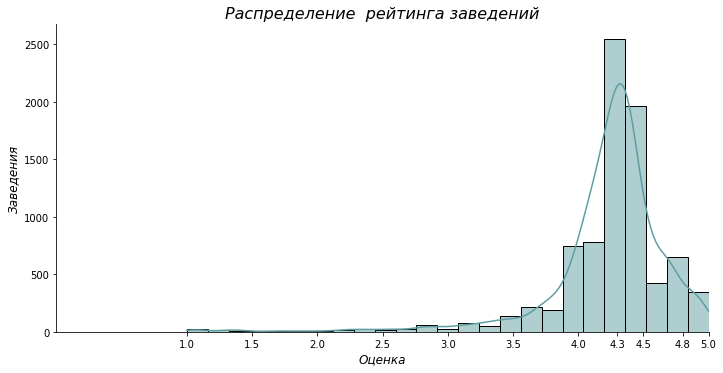

In [42]:
sns.displot(data, x='rating', kde=True, 
             bins=25, color = 'CadetBlue', aspect=2)
plt.title('Распределение  рейтинга заведений',fontstyle='italic', color = 'black', fontsize='16' )
plt.xlabel('Оценка', fontstyle='italic', color = 'black', fontsize='12', horizontalalignment='center')
plt.ylabel('Заведения', fontstyle='italic', color = 'black', fontsize='12', horizontalalignment='center')
plt.xticks(np.array([1, 1.5, 2, 2.5, 3, 3.5, 4, 4.3, 4.5, 4.8, 5]))
plt.xlim(0,5);

*Видим, что распределение скошено в право, то есть положительных оценок значительно больше. При этом чаще всего встречается рейтинг около значения 4,3.*

*Посмотрим, как различается рейтинг внутри категорий:*

In [43]:
data['avg_rating'] = data.groupby('category').rating.transform('median')
data = data.sort_values(by='avg_rating', ascending=False)

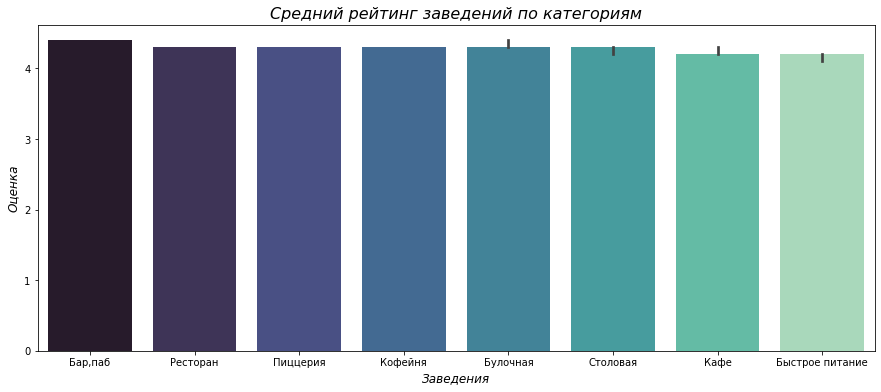

In [44]:
plt.figure(figsize=(15,6))
sns.barplot(x='category', y='rating', data=data, estimator=median,  palette="mako")
plt.title('Средний рейтинг заведений по категориям',fontstyle='italic', color = 'black', fontsize='16' )
plt.xlabel('Заведения', fontstyle='italic', color = 'black', fontsize='12', horizontalalignment='center')
plt.ylabel('Оценка', fontstyle='italic', color = 'black', fontsize='12', horizontalalignment='center'); 

*По столбчатой диаграмме видим, что значения средних значений рейтинга очень близки. Попробуем более наглядно изобразить на "ящиках с усами":* 

In [45]:
fig = px.box(data, x="category", y="rating", color="category",color_discrete_sequence=px.colors.qualitative.Bold)
fig.update_layout(title='Диаграмма распределения средних значений рейтинга по категориям', title_x=0.5)
fig.update_traces(quartilemethod="exclusive")
fig.update_layout(template='plotly_white')
fig.update_layout(xaxis_title='Категория заведения', yaxis_title='Рейтинг')
fig.update_layout(showlegend=False)
fig.show() 

**Здесь уже отчетливее - можем отметить самый высокий средний рейтинг в категории Бары, хотя само распределение и скошено влево за счёт выбросов низких оценок. Самый низкий рейтинг у Кафе, при этом он еще и скошен влево из-за большого количества низких оценок:**

In [46]:
data.pivot_table(index='category', values='rating', aggfunc='median').reset_index().sort_values(by='rating', ascending=False)

,category,rating
0,"Бар,паб",4.4
1,Булочная,4.3
4,Кофейня,4.3
5,Пиццерия,4.3
6,Ресторан,4.3
7,Столовая,4.3
2,Быстрое питание,4.2
3,Кафе,4.2


*Отобразим географическое измение среднего рейтинга на карте:*

In [47]:
rating = data.groupby('district', as_index=False)['rating'].agg('median')
rating

,district,rating
0,Восточный административный округ,4.3
1,Западный административный округ,4.3
2,Северный административный округ,4.3
3,Северо-Восточный административный округ,4.2
4,Северо-Западный административный округ,4.3
5,Центральный административный округ,4.4
6,Юго-Восточный административный округ,4.2
7,Юго-Западный административный округ,4.3
8,Южный административный округ,4.3


In [48]:
state_geo = '/datasets/admin_level_geomap.geojson'
moscow_lat, moscow_lng = 55.751244, 37.618423
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
Choropleth(
    geo_data=state_geo,
    data=rating,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.4,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)
m

*Добавим маркеры заведений на карту:*

In [49]:
marker_cluster = MarkerCluster().add_to(m)
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)
data.apply(create_clusters, axis=1)
m

**Обнаруживаем, что самый высокий рейтинг у заведений в Центральном округе, а самый низкий - на Северо и Юго-Востоке Москвы.**

### Проверим, на каких улицах чаще располагаются заведения.

In [50]:
top_15 = data.pivot_table(index='street', values='name', aggfunc='count').reset_index().sort_values(by='name', ascending=False)['street'].head(15)

In [51]:
street = data.pivot_table(index=['street', 'category'], values='name', aggfunc='count').reset_index().sort_values(by='name', ascending=False)
street.columns = ['Название улицы','Категория', 'Количество заведений']
street['Итого'] = street.groupby('Название улицы')['Количество заведений'].transform(sum)
street['Доля'] = round((street['Количество заведений']/street['Итого'])*100)
street['Доля'] = street['Доля'].astype(int).astype(str) + "%"
street = street.sort_values(by=['Итого', 'Название улицы', 'Категория'], ascending=[False, True, True]).reset_index(drop=True)

In [52]:
fig = px.bar(street[street['Название улицы'].isin(top_15)], x='Количество заведений', y='Название улицы', color='Категория', text='Доля', color_discrete_sequence=px.colors.qualitative.Set3)
fig.update_layout(title='ТОП-15 улиц с заведениями по категориям', title_x=0.5)
fig.update_layout(template='plotly_white')
fig.update_layout(xaxis_title='Количество заведений', yaxis_title='Название улицы')
fig.show() 

**Видим, что больше всего заведений на проспекте мира, причём в разных категориях. Образаем внимание, что в топе чаще встречаются улицы с оживлённым движением.**

*Посмотрим на улицы, где размещено не более одного заведения на карте.*

In [53]:
one = street[street['Доля'] == "100%"]['Название улицы']
one

1381     Юго-Восточный административный округ
1922                           1-я Квесисская
2368                        Кочновский проезд
2448                              Нижние Поля
2543                                   Юности
                        ...                  
3822                              сад Эрмитаж
3823                сквер имени М.И. Калинина
3824                          ул. Профсоюзная
3825                          ул. Ярославская
3826                                      № 7
Name: Название улицы, Length: 534, dtype: object

In [54]:
one_street = data.query('street.isin(@one)')
one_street

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,cat_count,new_category,avg_rating
4151,Барчук,"Бар,паб","Москва, Староваганьковский переулок, 19, стр. 3",Центральный административный округ,пн-ср 18:00–06:00; чт-вс 13:00–06:00,55.751195,37.606568,4.7,выше среднего,Цена бокала пива:300–500 ₽,NaN,NaN,False,45.0,Староваганьковский переулок,False,1,"Бар,паб",4.4
3962,"Бар, паб Проточный","Бар,паб","Москва, Проточный переулок, 2/1",Центральный административный округ,пн-чт 12:00–00:00; пт 12:00–02:00; сб 10:00–01...,55.750487,37.582043,4.6,NaN,NaN,NaN,NaN,False,NaN,Проточный переулок,False,1,"Бар,паб",4.4
4460,Траппист,"Бар,паб","Москва, Большой Черкасский переулок, 15-17с1",Центральный административный округ,"пн-чт 12:00–23:00; пт,сб 12:00–00:00; вс 12:00...",55.756708,37.626876,5.0,высокие,Цена бокала пива:250–450 ₽,NaN,NaN,False,NaN,Большой Черкасский переулок,False,1,"Бар,паб",4.4
3613,Tilda Food & Bar,"Бар,паб","Москва, Сытинский тупик, 5",Центральный административный округ,"ежедневно, 10:00–00:00",55.764440,37.600901,4.7,NaN,NaN,NaN,NaN,False,NaN,Сытинский тупик,False,1,"Бар,паб",4.4
4828,Method Beer & Munchies,"Бар,паб","Москва, Товарищеский переулок, 4, стр. 5",Центральный административный округ,"пн-чт 14:00–00:00; пт,сб 14:00–02:00; вс 14:00...",55.741614,37.659801,4.8,средние,Цена бокала пива:250–400 ₽,NaN,NaN,False,NaN,Товарищеский переулок,False,1,"Бар,паб",4.4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7522,Кафе,Кафе,"Москва, Юго-Восточный административный округ, ...",Юго-Восточный административный округ,NaN,55.651431,37.832642,4.8,NaN,NaN,NaN,NaN,False,NaN,Юго-Восточный административный округ,None,159,Кафе,4.2
7512,Кафе,Кафе,"Москва, улица Маршала Баграмяна, 2",Юго-Восточный административный округ,NaN,55.670123,37.788567,4.7,NaN,NaN,NaN,NaN,False,NaN,Маршала Баграмяна,None,159,Кафе,4.2
5446,Поляна парк кафе,Кафе,"Москва, Измайловский парк культуры и отдыха",Восточный административный округ,"ежедневно, 09:00–21:00",55.769644,37.748906,4.0,NaN,NaN,NaN,NaN,False,NaN,Измайловский парк культуры и отдыха,False,1,Кафе,4.2
7424,Пончики,Кафе,"Москва, парк имени Артёма Боровика",Юго-Восточный административный округ,"ежедневно, 10:00–21:00",55.661207,37.756636,4.1,средние,Средний счёт:200–450 ₽,325.0,NaN,True,NaN,парк имени Артёма Боровика,False,2,Кафе,4.2


In [55]:
moscow_lat, moscow_lng = 55.751244, 37.618423
m1 = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
marker_cluster = MarkerCluster().add_to(m1)
one_street.apply(create_clusters, axis=1)
m1

**Можем обратить внимание, что улицы с одним заведением это часто переулки и другие небольшие улицы, часто расположенные в центре города и/или  рядом с парковыми зонами.** 

*Посмотим, если отличие в среднем рейтинге заведений на улицах с одним заведением и улицах, где заведений больше одного:*

In [56]:
data['one_street'] = np.where(data['street'].isin(one), True, False)

In [57]:
data.head(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,cat_count,new_category,avg_rating,one_street
3913,Гамбринус,"Бар,паб","Москва, Зубовский бульвар, 13, стр. 2",Центральный административный округ,"пн-пт 11:00–00:00; сб,вс 12:00–00:00",55.735376,37.592350,4.5,высокие,Средний счёт:1500–2000 ₽,1750.0,NaN,True,50.0,Зубовский бульвар,False,7,"Бар,паб",4.4,False
1683,Фактура,"Бар,паб","Москва, Большая Новодмитровская улица, 36, стр. 4",Северо-Восточный административный округ,"ежедневно, 12:00–23:00",55.804629,37.585913,4.3,выше среднего,Средний счёт:1200 ₽,1200.0,NaN,False,60.0,Большая Новодмитровская,False,1,"Бар,паб",4.4,False
4151,Барчук,"Бар,паб","Москва, Староваганьковский переулок, 19, стр. 3",Центральный административный округ,пн-ср 18:00–06:00; чт-вс 13:00–06:00,55.751195,37.606568,4.7,выше среднего,Цена бокала пива:300–500 ₽,NaN,NaN,False,45.0,Староваганьковский переулок,False,1,"Бар,паб",4.4,True
1063,Барслона,"Бар,паб","Москва, проспект Мира, 211к2",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.845159,37.661179,4.1,NaN,NaN,NaN,NaN,False,NaN,проспект Мира,False,1,"Бар,паб",4.4,False
3390,Cépage Kitchen & Bar,"Бар,паб","Москва, улица Красная Пресня, 32-34с3",Центральный административный округ,"пн-пт 07:30–00:00; сб,вс 10:00–00:00",55.762733,37.568050,4.4,выше среднего,Средний счёт:от 1500 ₽,1500.0,NaN,False,NaN,Красная Пресня,False,1,"Бар,паб",4.4,False


*Посмотрим, как отличается рейтинг заведений, расположенных по одному на улице и тех, где заведения соседствуют с другими на улице:*

In [58]:
fig = px.violin(data, y="rating", x="one_street", color="one_street", box=True, points="all", color_discrete_sequence=px.colors.qualitative.Bold)
fig.update_layout(template='plotly_white')
fig.show()

**Видим, что в общем случае средний рейтинг таких заведений не различается, и распределения рейтинга похожи, однако можно отметить, что у одиноких заведений реже встречаются самые низкие оценки - возможно в таких заведениях больше внимания удиляют качеству, чтобы привлечь гостей**. 

*Посмотрим на рейтинг "одиноких" и "не одиноких" заведений в разрезе категорий:*

**Обращаем внимание, что для категорий "Кафе", "Ресторан", "Кофейня" и Пиццерия значимых различий в рейтинге не наблюдается, а вот в случае категорий "Бар, Паб", "Быстрое питание", Булочная", "Столовая" рейтинг одиноких заведений на улице в среднем выше.**

### Как отличается средний чек в заведениях.

*Посмотрим детальнее на распределение среднего чека в общем случае:*

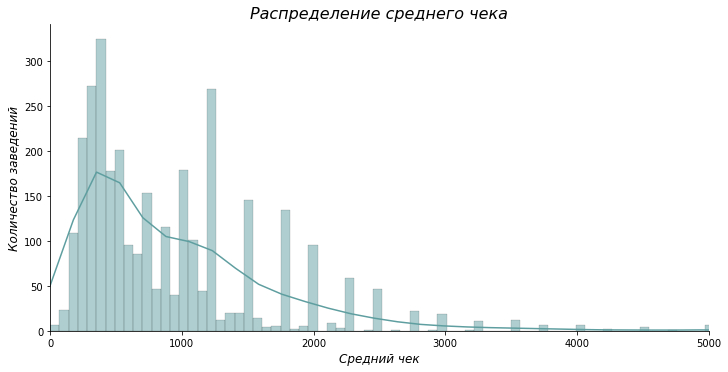

In [59]:
sns.displot(data, x='middle_avg_bill', kde=True, 
             bins=500, color = 'cadetblue', aspect=2)
plt.title('Распределение среднего чека',fontstyle='italic', color = 'black', fontsize='16')
plt.xlabel('Средний чек', fontstyle='italic', color = 'black', fontsize='12', horizontalalignment='center')
plt.ylabel('Количество заведений', fontstyle='italic', color = 'black', fontsize='12', horizontalalignment='center')
plt.xlim(0,5000);

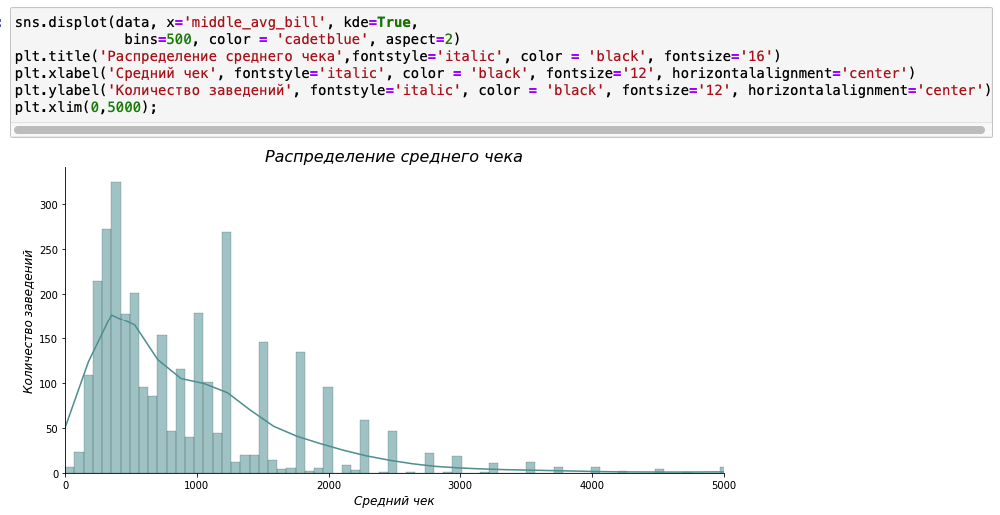

**Видим, что распределение далеко от нормального и график смещен вправо, то есть за среднее значение будем брать медиану.**

*Проверим, как распределяется средний чек внутри категорий:*

In [60]:
fig = px.box(data.sort_values(by='category'), x="category", y="middle_avg_bill", color="category",color_discrete_sequence=px.colors.qualitative.Bold,title='Диаграмма распределения среднего чека по категориям')
fig.update_traces(quartilemethod="exclusive")
fig.update_layout(template='plotly_white')
fig.update_layout(xaxis_title='Категория заведения', yaxis_title='Средний чек')
fig.show() 

*На этом графике выброс в среднем счете в категории "Рестораны" мешает нам увидеть картину четко. Построим новый график, поставив лимит по среднему чеку до 10 000 руб:* 

In [61]:
fig = px.box(data.query('middle_avg_bill < 10000'), x="category", y="middle_avg_bill", color="category",color_discrete_sequence=px.colors.qualitative.Bold, points="all")
fig.update_layout(title='Диаграмма распределения  значений среднего чека по категориям', title_x=0.5)
fig.update_layout(template='plotly_white')
fig.update_layout(xaxis_title='Категория заведения', yaxis_title='Средний чек')
fig.update_layout(showlegend=False)
fig.show()

**Здесь уже можем отметить, что самые высокие средние чеки в категориях "Бар,паб" и "Ресторан". При этом, если в барах распределение смещено влево, то есть большое количество заведений в значительно более низкой ценовой категории, то в ресторанах обратная ситуация - много выбросов в более высокой ценовой категории. Также можн отметить, что самый низкий средний чек в Столовых.** 

In [62]:
data.pivot_table(index='category', values='middle_avg_bill', aggfunc='median').reset_index().sort_values(by='middle_avg_bill', ascending=False)

,category,middle_avg_bill
0,"Бар,паб",1250.0
6,Ресторан,1250.0
3,Кафе,600.0
5,Пиццерия,600.0
1,Булочная,500.0
2,Быстрое питание,400.0
4,Кофейня,400.0
7,Столовая,300.0


*Посмотрим  на карте, как отличается средний чек в разных районах Москвы:*

In [63]:
district_price =  data.groupby('district', as_index=False)['middle_avg_bill'].agg('median')
district_price

,district,middle_avg_bill
0,Восточный административный округ,575.0
1,Западный административный округ,1000.0
2,Северный административный округ,650.0
3,Северо-Восточный административный округ,500.0
4,Северо-Западный административный округ,700.0
5,Центральный административный округ,1000.0
6,Юго-Восточный административный округ,450.0
7,Юго-Западный административный округ,600.0
8,Южный административный округ,500.0


In [64]:
state_geo = '/datasets/admin_level_geomap.geojson'
moscow_lat, moscow_lng = 55.751244, 37.618423
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
Choropleth(
    geo_data=state_geo,
    data=district_price,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='Reds',
    fill_opacity=0.4,
    legend_name='Медианный средний чек по округам',
).add_to(m)
m

*Видим, что самый высокий средний чек в заведениях на западе Москвы*

### Проверим, зависит ли рейтинг заведений от среднего чека. 

*Посмотрим на корреляцию рейтинга и среднего чека в общем случае:*

,rating,middle_avg_bill
rating,1.000000,-0.186149
middle_avg_bill,-0.186149,1.000000


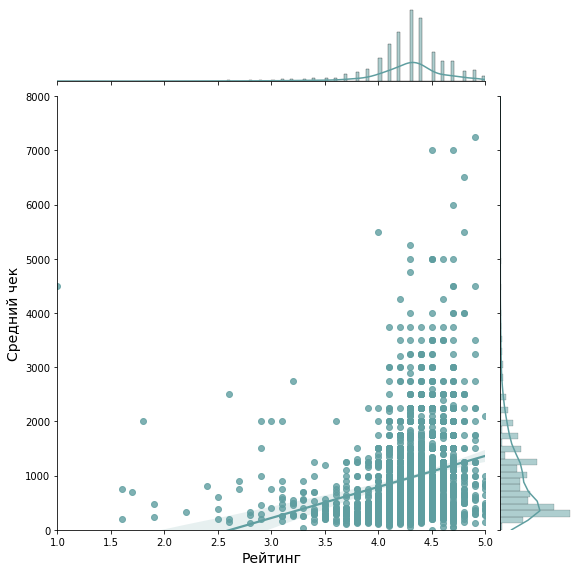

In [65]:
h = sns.jointplot(x='rating', y='middle_avg_bill', data=data, kind='reg',height=8, color="cadetblue")
h.set_axis_labels('Рейтинг', 'Средний чек', fontsize=14)
plt.ylim(0,8000);
display(data.pivot_table(index='rating', values='middle_avg_bill').reset_index().corr())

**Обращаем внимание на отрицательную регрессию, то есть при снижении среднего чека рейтинг заведения имеет тенденцию к росту.**

*Посмотрим, наблюдается ли такая же тенденция во всех категориях:*

In [66]:
category = data['category'].unique()

'Бар,паб'

,rating,middle_avg_bill
rating,1.000000,0.579288
middle_avg_bill,0.579288,1.000000


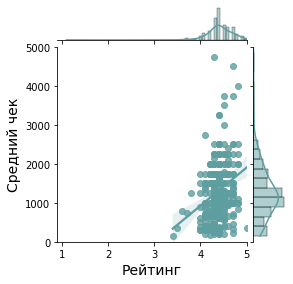

'Ресторан'

,rating,middle_avg_bill
rating,1.000000,0.404297
middle_avg_bill,0.404297,1.000000


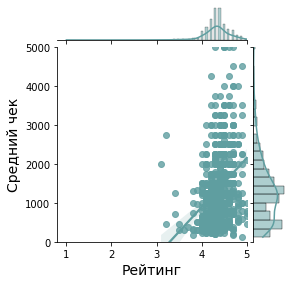

'Пиццерия'

,rating,middle_avg_bill
rating,1.000000,0.380346
middle_avg_bill,0.380346,1.000000


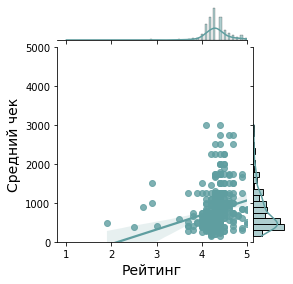

'Кофейня'

,rating,middle_avg_bill
rating,1.000000,0.477901
middle_avg_bill,0.477901,1.000000


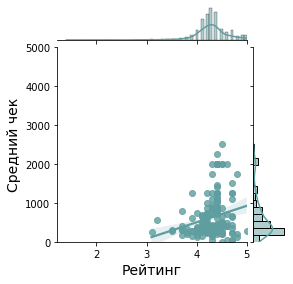

'Булочная'

,rating,middle_avg_bill
rating,1.000000,0.227137
middle_avg_bill,0.227137,1.000000


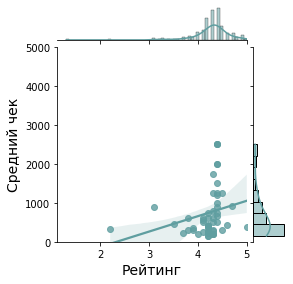

'Столовая'

,rating,middle_avg_bill
rating,1.000000,-0.440746
middle_avg_bill,-0.440746,1.000000


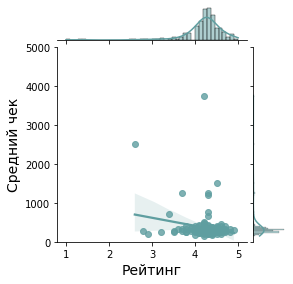

'Кафе'

,rating,middle_avg_bill
rating,1.000000,-0.367218
middle_avg_bill,-0.367218,1.000000


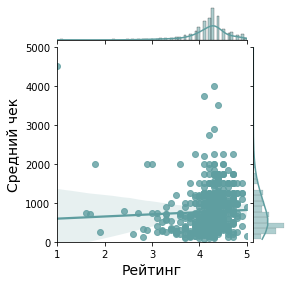

'Быстрое питание'

,rating,middle_avg_bill
rating,1.00000,0.58482
middle_avg_bill,0.58482,1.00000


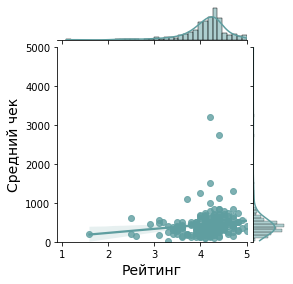

In [67]:
for row in category:
        r = sns.jointplot(x='rating', y='middle_avg_bill', data=data[data['category'] == row], kind='reg',height=4, color="cadetblue")
        r.set_axis_labels('Рейтинг', 'Средний чек', fontsize=14)
        plt.ylim(0,5000)
        display(row, data[data['category'] == row].pivot_table(index='rating', values='middle_avg_bill').reset_index().corr())
        plt.show()

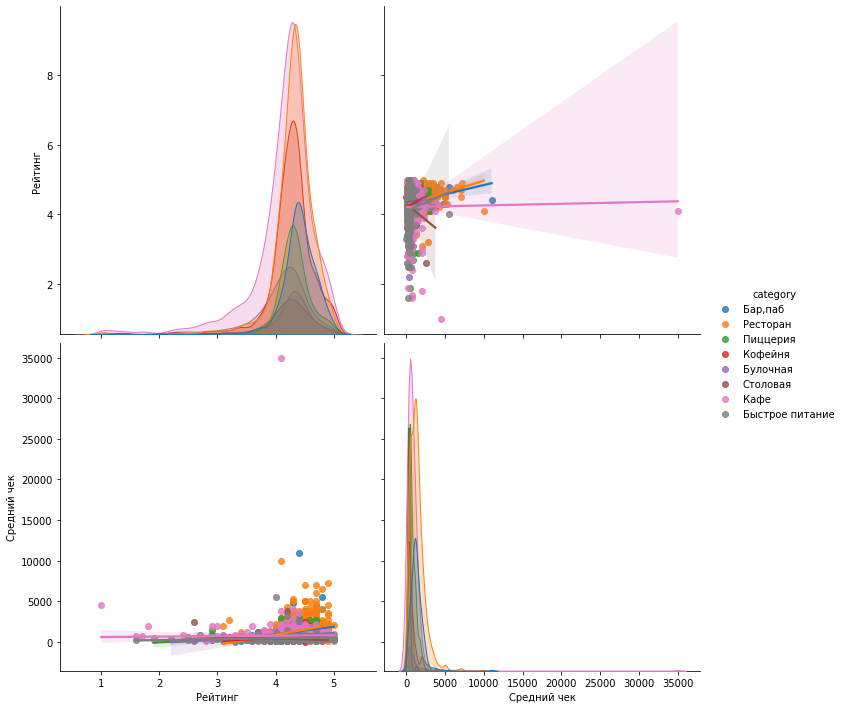

In [68]:
sns.pairplot(data.rename(columns={'rating':'Рейтинг', 'middle_avg_bill':'Средний чек'}), vars=['Рейтинг', 'Средний чек'],  kind='reg', hue='category', height=5);

**В разрезе категорий наблюдаем несколько иную картину. Так, в случае с Кафе и Столовыми тенденция совпадает с общей, однако в других категорий корреляция положительная, то есть при росте среднего чека и рейтинг заведения повышается. Таким образом можно предположить, что в случае с Кафе и Столовыми более низкая стоимость явлется конкурентным преимуществом, в то время как в остальных категориях вероятно влияют качественные характеристики. Также можно отметить, что в виду большого количества завдений Категории Кафе, в общем случае картина искажается и делать выводы по общим данным не стоит.**  

### Велика доля завдений 24/7 и как они распределяются по регионам Москвы.

*Посмотрим на долю заведений 24/7 от общего количества заведений:* 

In [69]:
fig = go.Figure(data=[go.Pie(labels=['Не 24/7','24/7'], values=data.groupby('is_24/7').agg({'name':'count'})['name'], textinfo='value+label+percent', pull=[0.1, 0])])
fig.update_layout(title="Доля заведений, работающих 24/7", title_x=0.5)
fig.update_layout(
    autosize=False,
    width=600,
    height=600)
fig.update_layout(showlegend=False)
fig.update_traces(marker=dict(colors=['e63946','1d3557']))
fig.show()

**Среди всех завдений Москвы только 9,28% работают ежедневно и круглосуточно:**

*Посмотрим, в каких районах располагаются такие заведения и в каких категориях:*

In [70]:
d_n = data[data['is_24/7'] == 1].pivot_table(index=['district','category'], values='name', aggfunc='count').reset_index()
d_n['district'] = d_n['district'].str.replace(" административный округ", "")
d_n.sort_values(by=['district', 'name'])
d_n['sum'] = d_n.groupby('district').name.transform(sum)
d_n['rate'] = round((d_n['name']/d_n['sum'])*100)
d_n['rate'] = d_n['rate'].astype(int).astype(str) + "%"
d_n.columns = ['Округ', 'Категория', 'Количество заведений 24/7 в категории', 'Количество заведений 24/7 в округе', 'Доля категории']
d_n = d_n.sort_values(by=['Количество заведений 24/7 в округе','Количество заведений 24/7 в категории'], ascending=[False, False])
d_n

,Округ,Категория,Количество заведений 24/7 в категории,Количество заведений 24/7 в округе,Доля категории
37,Центральный,"Бар,паб",29,131,22%
43,Центральный,Ресторан,27,131,21%
40,Центральный,Кафе,26,131,20%
41,Центральный,Кофейня,26,131,20%
39,Центральный,Быстрое питание,17,131,13%
...,...,...,...,...,...
36,Северо-Западный,Ресторан,13,43,30%
32,Северо-Западный,Быстрое питание,7,43,16%
31,Северо-Западный,Булочная,3,43,7%
34,Северо-Западный,Кофейня,3,43,7%


In [71]:
fig = px.bar(d_n, x='Округ', y='Количество заведений 24/7 в категории', color='Категория', text='Доля категории', color_discrete_sequence=px.colors.qualitative.Set3)
fig.update_layout(title='Количество и доля заведений 24/7 по округам', title_x=0.5)
fig.update_layout(template='plotly_white')
fig.update_layout(xaxis_title='Округ Москвы', yaxis_title='Количество заведений 24/7 в округе')
fig.show() 

**Видим, что больше всего заведений 24/7 в Центральном округе. При этом чаще всего больше всего в районах круглосуточных Кафе, выделяется Северо-Западный округ - там больше ресторанов 24/7.**

<div class="alert alert-block alert-success">✔️
    

__Комментарий от ревьюера №2__

Согласен, ЦАО снова в лидерах

*Посмотрим, как отличается распределение рейтинга заведений, работающих 24/7 и других:*

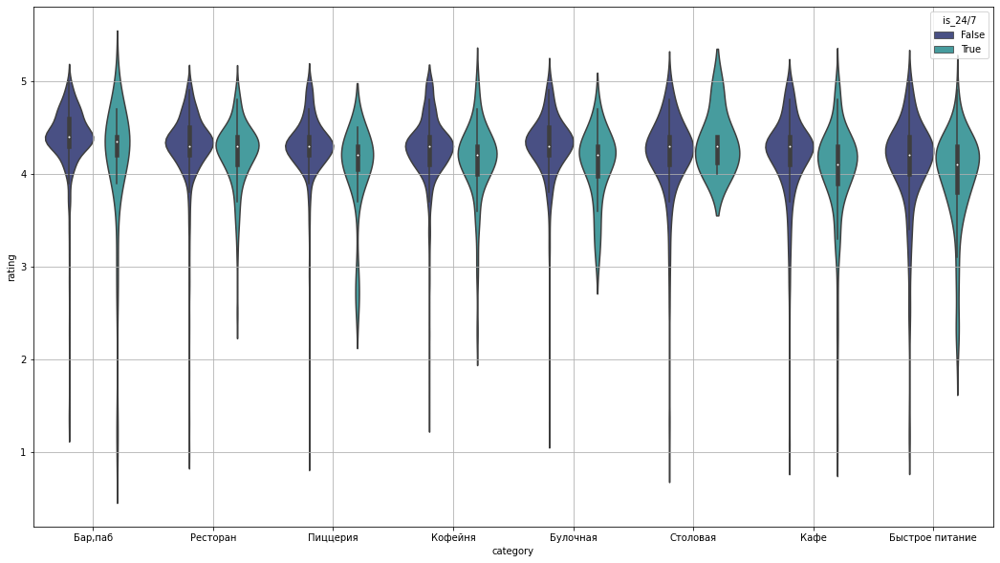

In [72]:
plt.figure(figsize=(18, 10))
sns.violinplot(data=data, x="category", y="rating", hue="is_24/7", palette="mako")
plt.grid()
plt.show();

**Чаще всего рейтьинг заведений 24/7 отличается в худшую сторону - возможно это связано с тем, что качественные характеристики в таких заведениях снижены. Однако в случае с категориями "Бар, Паб" и  "Ресторан" средний рейтинг практически не отличается, а в случае с барами распределение смещено вправо, то есть у заведений этой категории вероятность получить более высокую оценку больше, если оно работает 24/7.** 

### Вывод по категориям:

In [73]:
cat = data.pivot_table(index='category', values=['rating', 'middle_avg_bill']).reset_index().rename(columns={'category':'Категория', 'middle_avg_bill':'Средний счёт', 'rating':'Рейтинг'}).sort_values(by='Средний счёт', ascending=False)

In [74]:
fig = px.bar(cat, x='Категория', y='Средний счёт', color='Рейтинг', color_continuous_scale=px.colors.sequential.Blues)
fig.update_layout(showlegend=False)
fig.update_layout(template='plotly_white')
fig.update_layout(xaxis_title="Категория", yaxis_title="Средний счёт, в рублях")
fig.show() 

**Вот, что мы узнали о категориях заведений общественного питания Москвы:**
   + В интернете чаще интересуются ресторанами в Москве, при   этом самые распространенные заведения  - Кафе.
   + Наибольшее число гостей смогут принять рестораны. А среди сетевых заведений лидируют Кофейни.
   + Больше всего заведений разных категорий вы встретите в Центральном административном округе Москвы. А наибольшее количество Кофеен расположено на проспекте Мира.
   + Самый высокий средний рейтинг у заведений, расположенных в Центральном административном округе. А больше всего потратиться нужно будет в заведениях в центре и на западе Москвы, в виду наибольшего среднего чека.
   + В большинстве категорий можно отметить взаимосвязь, что,  чем выше средний чек, тем выше и рейтинг заведения. В то время как для Кафе и Столовых ситуация обратная.
   + Самое высокое соотношение среднего чека и рейтинга заведения для Баров, Пабов. 

## Анализ категории "Кофейня"

*Посмотрим, какие ключевые слова, связанные с категорией Кофейня, ищут в интернете в регионе Москва и отобразим на графике:*

In [75]:
stat_с = {'Ключевые слова': ['Кофейня', 'Шоколадница', 'Кофемания', 'Кофе с собой', 'Лучшая кофейня Москвы', 'Кофейня метро', 'Кофейня улица'],'Количество запросов в месяц': [101281, 85622 , 38634, 659651, 687, 1399, 579]} 
stat_с = pd.DataFrame(stat_с)
stat_с['popularity'] = [126,367, 550, 117, 505, 468, 153]
stat_с = stat_с.sort_values(by='Количество запросов в месяц', ascending=False).rename(columns={'popularity':'Популярность', 'requests':'Количество запросов'})
stat_с

,Ключевые слова,Количество запросов в месяц,Популярность
3,Кофе с собой,659651,117
0,Кофейня,101281,126
1,Шоколадница,85622,367
2,Кофемания,38634,550
5,Кофейня метро,1399,468
4,Лучшая кофейня Москвы,687,505
6,Кофейня улица,579,153


In [76]:
fig = px.bar(stat_с, x='Ключевые слова', y='Популярность', color='Количество запросов в месяц', color_continuous_scale=px.colors.sequential.Blues)
fig.update_layout(showlegend=False)
fig.update_layout(template='plotly_white')
fig.update_layout(xaxis_title="Категория", yaxis_title="Популярность в регионе, в %")
fig.show()

**Чаще всего всего в поиске набирают "Кофе с собой", а наибольшую популярность в регионе имеет сеть кофеен "Кофемания". Можно также отметить, что чаще кофейни ищут по ближайшей станции метро, а не по улице расположения.**

*Отфильтруем наш датасет по категории "Кофейня" и посмотрим информацию по имеющимся данным:*

In [77]:
coffee_shop = data.query('category == "Кофейня"')

In [78]:
coffee_shop.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1373 entries, 3509 to 4317
Data columns (total 20 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               1373 non-null   object 
 1   category           1373 non-null   object 
 2   address            1373 non-null   object 
 3   district           1373 non-null   object 
 4   hours              1361 non-null   object 
 5   lat                1373 non-null   float64
 6   lng                1373 non-null   float64
 7   rating             1373 non-null   float64
 8   price              464 non-null    object 
 9   avg_bill           709 non-null    object 
 10  middle_avg_bill    193 non-null    float64
 11  middle_coffee_cup  516 non-null    float64
 12  chain              1373 non-null   bool   
 13  seats              734 non-null    float64
 14  street             1373 non-null   object 
 15  is_24/7            1361 non-null   object 
 16  cat_count          13

*Видим, что очень много пропущенных значений в информации о ценах. Так больше всего непустых значений в стобце со средней ценой чашки кофе, то средние цены иммет смысл оценивать по этому параметру*

In [79]:
coffee_shop.head(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,cat_count,new_category,avg_rating,one_street
3509,Кофемания,Кофейня,"Москва, Кудринская площадь, 46/54с1",Центральный административный округ,"ежедневно, круглосуточно",55.758268,37.585356,4.4,высокие,Средний счёт:1500–2500 ₽,2000.0,NaN,True,NaN,Кудринская площадь,True,22,Кофейня,4.3,False
3685,Кофемания,Кофейня,"Москва, Большая Никитская улица, 13",Центральный административный округ,"ежедневно, круглосуточно",55.756507,37.604838,4.5,высокие,Средний счёт:2500 ₽,2500.0,NaN,True,148.0,Большая Никитская,True,22,Кофейня,4.3,False
7818,Кофейник,Кофейня,"Москва, Михневская улица, 2Д, стр. 4",Южный административный округ,"пн-пт 07:00–21:00; сб,вс 08:00–21:00",55.581907,37.660898,4.1,низкие,Средний счёт:140–142 ₽,141.0,NaN,True,NaN,Михневская,False,1,Кофейня,4.3,False
1163,Кофейня,Кофейня,"Москва, проспект Мира, 119с71",Северо-Восточный административный округ,NaN,55.830040,37.633969,4.4,NaN,NaN,NaN,NaN,False,NaN,проспект Мира,None,9,Кофейня,4.3,False
3013,Кофемания,Кофейня,"Москва, Осенняя улица, 11",Западный административный округ,пн-ср 08:00–23:00; чт-сб 08:00–00:00; вс 08:00...,55.762272,37.404399,4.9,NaN,NaN,NaN,NaN,True,70.0,Осенняя,False,22,Кофейня,4.3,False


### Пострим, как распределено количество кофеен по районам Москвы.

*Построим круговую диаграмму с количеством и долей кофеен в кадлом районе:*

In [80]:
dis = coffee_shop.pivot_table(index='district', values='name', aggfunc='count').reset_index()
dis['district'] = dis['district'].str.replace(' административный округ', "")
dis = dis.sort_values(by='name', ascending=False)
dis

,district,name
5,Центральный,419
2,Северный,188
3,Северо-Восточный,149
1,Западный,143
8,Южный,128
0,Восточный,101
6,Юго-Восточный,92
7,Юго-Западный,91
4,Северо-Западный,62


In [81]:
colors_2 = {'Центральный':'032b43',
         'Северный':'68b0ab',
         'Северо-Восточный':'f5ebe0',
         'Западный':'9f86c0',
         'Южный':'e56b6f',
         'Восточный':'ffd166',
         'Юго-Западный':'3e92cc',
         'Юго-Восточный':'d2d7df',
          'Северо-Западный':'ffafcc'}
fig = go.Figure(data=[go.Pie(labels=dis['district'], values=dis['name'],hole=0.3,textinfo='percent+value+label', marker_colors=dis["district"].map(colors_2))])
fig.update_layout(title="Количество Кофеен в районах Москвы", title_x=0.5)
fig.update_layout(
    autosize=False,
    width=900,
    height=900)
fig.update_layout(showlegend=False)
fig.show()

**Видим, что больше всего Кофеен в Центральном округе, меньше всего в Северо-Западном.**

### Проверим, у каких станций Метро чаще располагаются Кофейни.

*Получим список станций Метро с координатами широты и долготы:* 

In [82]:
URL  = 'https://api.hh.ru/metro/1'
req = requests.get(URL)

In [83]:
response = json.loads(req.text)

In [84]:
metro_map = (pd.io.json.json_normalize(response,
                                 ['lines', 'stations'],
                                 ['id', ['lines', 'name']],
                                 meta_prefix='Line_')
         .assign(Name_Top='Москва'))

/tmp/ipykernel_62/1161787984.py:1: FutureWarning:

pandas.io.json.json_normalize is deprecated, use pandas.json_normalize instead



In [85]:
metro_map.head(5)

,id,name,lat,lng,order,line.id,line.hex_color,line.name,Line_id,Line_lines.name,Name_Top
0,8.189,Новокосино,55.745113,37.864052,0,8,FFCD1C,Калининская,1,Калининская,Москва
1,8.88,Новогиреево,55.752237,37.814587,1,8,FFCD1C,Калининская,1,Калининская,Москва
2,8.107,Перово,55.750980,37.784220,2,8,FFCD1C,Калининская,1,Калининская,Москва
3,8.158,Шоссе Энтузиастов,55.758090,37.751703,3,8,FFCD1C,Калининская,1,Калининская,Москва
4,8.1,Авиамоторная,55.751933,37.717444,4,8,FFCD1C,Калининская,1,Калининская,Москва


In [86]:
metro = metro_map[['name', 'lat', 'lng']]

*Переведём таблицу с координатами в кортежи и возмём функцию для расчета ближайшей станции Метро и расстояния до неё по координатам заданной точки*

In [87]:
metro_points = {x[0]: x[1:] for x in metro.itertuples(index=False)}

In [88]:
def distance_haversine(point_1: tuple, point_2: tuple):
    d_earth = 2.0 * 6372.8
    lat1, long1 = tuple(radians(c) for c in point_1)
    lat2, long2 = tuple(radians(c) for c in point_2)
    d = sin((lat2 - lat1) / 2.0) ** 2.0 + cos(lat1) * cos(lat2) * sin(
        (long2 - long1) / 2.0) ** 2.0
    return d_earth * asin(d ** 0.5)


def find_nearest(point_1: tuple, points: dict):
    dists = {p: distance_haversine(point_1, points[p]) for p in points}
    name, dist = min(dists.items(), key=lambda d: d[1])
    return name, dist #{'name': name, 'distance': dist,
            #'dist_coef': 3 if dist <= 1.0 else 2 if dist < 2.0 else 1}

*Напишем фукцию, которая вернет ближайшую станцию метро для координат кофейни в нашем датасете:*

In [89]:
def test(df):
        station={}
        for i in df.index:
            station[i] = []
            j,k = find_nearest((df['lat'][i], df['lng'][i]), metro_points)
            station[i].append(j)
        return station

In [90]:
coffee_shop = coffee_shop.reset_index(drop=True) 

*Преобразуем получившийся словарь в датафрейм и добавим столбец с ближайшей станцией метро к нашим данным по Кофейням*

In [91]:
station = pd.DataFrame.from_dict(test(coffee_shop),orient='index', columns=['station'])
coffee_shop['station'] = station

In [92]:
coffee_shop.head(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,cat_count,new_category,avg_rating,one_street,station
0,Кофемания,Кофейня,"Москва, Кудринская площадь, 46/54с1",Центральный административный округ,"ежедневно, круглосуточно",55.758268,37.585356,4.4,высокие,Средний счёт:1500–2500 ₽,2000.0,NaN,True,NaN,Кудринская площадь,True,22,Кофейня,4.3,False,Баррикадная
1,Кофемания,Кофейня,"Москва, Большая Никитская улица, 13",Центральный административный округ,"ежедневно, круглосуточно",55.756507,37.604838,4.5,высокие,Средний счёт:2500 ₽,2500.0,NaN,True,148.0,Большая Никитская,True,22,Кофейня,4.3,False,Арбатская
2,Кофейник,Кофейня,"Москва, Михневская улица, 2Д, стр. 4",Южный административный округ,"пн-пт 07:00–21:00; сб,вс 08:00–21:00",55.581907,37.660898,4.1,низкие,Средний счёт:140–142 ₽,141.0,NaN,True,NaN,Михневская,False,1,Кофейня,4.3,False,Красный строитель
3,Кофейня,Кофейня,"Москва, проспект Мира, 119с71",Северо-Восточный административный округ,NaN,55.830040,37.633969,4.4,NaN,NaN,NaN,NaN,False,NaN,проспект Мира,None,9,Кофейня,4.3,False,Улица Сергея Эйзенштейна
4,Кофемания,Кофейня,"Москва, Осенняя улица, 11",Западный административный округ,пн-ср 08:00–23:00; чт-сб 08:00–00:00; вс 08:00...,55.762272,37.404399,4.9,NaN,NaN,NaN,NaN,True,70.0,Осенняя,False,22,Кофейня,4.3,False,Крылатское


*Посмотрим, у каких метро чаще всего располагаются Кофейни. Возьмём ТОП-15 станций метро по количеству кофеен рядом:*

In [93]:
nearest_metro = coffee_shop.pivot_table(index='station', values='name', aggfunc='count').reset_index().sort_values(by='name',ascending=False)
nearest_metro.head(15)

,station,name
162,Савёловская,25
152,Проспект Мира,22
47,Дмитровская,21
15,Бауманская,20
198,Улица 1905 года,20
130,Павелецкая,18
33,Водный стадион,18
181,Таганская,18
133,Парк культуры,17
119,Новокузнецкая,15


In [94]:
nearest_metro = nearest_metro.head(15)
colors_3 = {'Савёловская':'e5e5e5',
         'Бауманская':'1d3557',
         'Дмитровская':'e5e5e5',
         'Улица 1905 года':'8e7dbe',
         'Проспект Мира':'fb8500',
         'Павелецкая':'bc6c25',
         'Парк культуры':'bc6c25',
         'Водный стадион':'90be6d',
          'Домодедовская':'90be6d',
           'Таганская':'bc6c25',
           'Новокузнецкая':'ffd60a',
          'Курская':'bc6c25',
           'Университет':'e63946',
           'Шелепиха':'ffc8dd',
           'Сокол':'90be6d'}
fig = go.Figure(data=[go.Pie(labels=nearest_metro['station'], values=nearest_metro['name'],hole=0.3,textinfo='value+label',marker_colors=nearest_metro["station"].map(colors_3), pull=[0.1, 0, 0, 0, 0, 0 ,0, 0, 0, 0, 0, 0, 0, 0, 0])])
fig.update_layout(title="ТОП-15 метро по количеству кофеен рядом", title_x=0.5)
fig.update_layout(
    autosize=False,
    width=900,
    height=900)
fig.update_layout(showlegend=False)
fig.show()

**Отмечаем, что больше всего Кофеен рядом с метро Савеловская.Также можем отметить, что в Топ-15 попали узловые метро, где происходят пересадки, а также, метро, рядом с которыми расположены крупные Университеты.**

### Посмотрим, на каких улицах располгается больше всего Кофеен.

In [95]:
st = coffee_shop.pivot_table(index=['street', 'station'], values='name', aggfunc='count').reset_index().sort_values(by=['street', 'name'], ascending=[True,False])
st['sum'] = st.groupby('street').name.transform(sum)
st = st.sort_values(by=['sum','name'], ascending=[False,False])
s = coffee_shop.groupby('street').agg({'name':'count'}).reset_index().sort_values(by='name', ascending=False)['street'].head(15)
st = st.query('street.isin(@s)')

In [96]:
fig = px.bar(st, x='street', y='name', color='station', text='station', color_discrete_sequence=px.colors.qualitative.Set3)
fig.update_layout(title="ТОП-15 улиц по количеству Кофеен в разрезе ближайших станций метро", title_x=0.5)
fig.update_xaxes(tickangle=45)
fig.update_layout(template='plotly_white')
fig.update_layout(xaxis_title='Название улицы', yaxis_title='Количество заведений')
fig.update_layout(
    autosize=False,
    width=800,
    height=800)
fig.update_layout(showlegend=False)
fig.show() 

**Отмечаем, что больше всего Кофеен на проспекте Мира. Также можем заметить, что в Топ-15 много шоссе с высоким траффиком.**

### Что влияет на рейтинг Кофеен. 

*Добавим в наши данные фактор расстояния до ближайшего Метро:*

In [97]:
def test_2(df):
        distance={}
        for i in df.index:
            distance[i] = []
            j,k = find_nearest((df['lat'][i], df['lng'][i]), metro_points)
            distance[i].append(k)
        return distance

In [98]:
distance = pd.DataFrame.from_dict(test_2(coffee_shop),orient='index', columns=['station'])
coffee_shop['distance'] = distance

In [99]:
coffee_shop['distance'] = coffee_shop['distance'].astype(float)

In [100]:
#cof = coffee_shop[['name','district','rating','price', 'middle_coffee_cup','chain', 'seats', 'street', 'is_24/7', 'distance']]

*Посчитаем корреляцию и построим матрицу диаграмм рассеяния:*

In [101]:
coffee_shop.pivot_table(index='rating', values=['seats','middle_coffee_cup', 'distance', 'chain' ]).reset_index().corr()

,rating,chain,distance,middle_coffee_cup,seats
rating,1.000000,-0.436762,0.107156,0.773365,0.115085
chain,-0.436762,1.000000,-0.042985,-0.651524,-0.116432
distance,0.107156,-0.042985,1.000000,-0.217267,-0.034586
middle_coffee_cup,0.773365,-0.651524,-0.217267,1.000000,0.326943
seats,0.115085,-0.116432,-0.034586,0.326943,1.000000


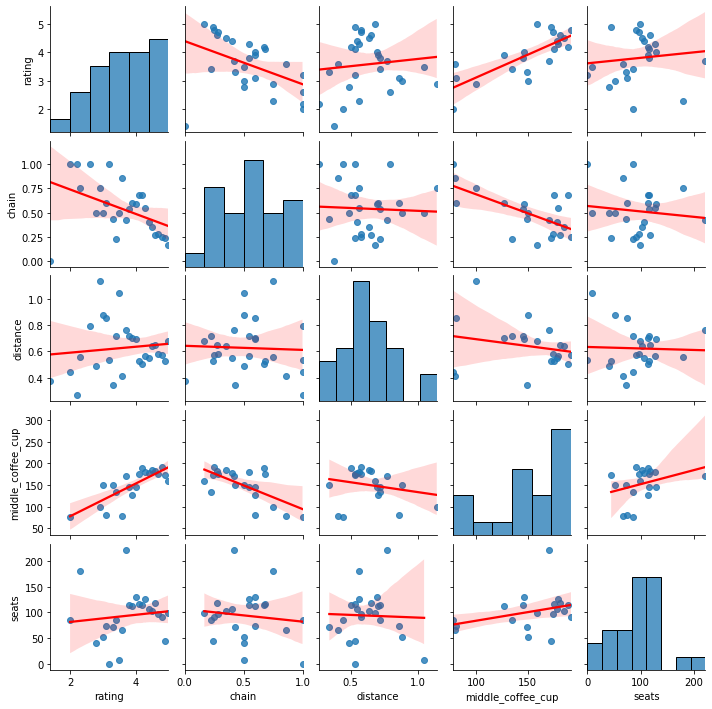

In [102]:
sns.pairplot(coffee_shop.pivot_table(index='rating', values=['seats','middle_coffee_cup','distance', 'chain']).reset_index(), kind="reg",plot_kws={'line_kws':{'color':'red'}}, height=2
        ) 
plt.show()

**Можем отметить следующие моменты:**
   + У сетевых кофеен рейтинг в среднем ниже;
   + Чем ближе Кофейня к Метро, тем в среднем ниже её рейтинг;
   + При этом средняя цена чашки капучино в среднем тем ниже, чем Кофейня дальше от Метро;
   + Положительная высокая корреляция между средней ценой чашки капучино и рейтингом - чем выше цена, тем выше рейтинг;
   + Небольшая положительная корреляция между средней ценой чашки капучино и количеством мест - чем больше мест в Кофейне, тем выше цена кофе.

### Сетевые и несетевые Кофейни; Кофейни, работающие 24/7. 

*Посмотрим, каких кофеен больше - сетевых или не сетевых:*

In [103]:
fig = go.Figure(data=[go.Pie(labels=['Несетевые','Сетевые'], values=coffee_shop.groupby('chain').agg({'name':'count'})['name'], textinfo='value+label+percent', pull=[0.1, 0])])
fig.update_layout(title="Количество сетевых и несетевых коффеен ", title_x=0.5)
fig.update_layout(
    autosize=False,
    width=600,
    height=600)
fig.update_layout(showlegend=False)
fig.update_traces(marker=dict(colors=['e63946','1d3557']))
fig.show()

**Сетевых Кофеен чуть больше**

*Посмотрим, какое среднее количество мест в сетевых и несетевых Кофейнях*

In [104]:
fig = go.Figure(data=[go.Pie(labels=['Несетевые','Сетевые'], values=coffee_shop.groupby('chain').agg({'seats':'median'})['seats'], textinfo='value+label', pull=[0.1, 0])])
fig.update_layout(title="Количество мест в сетевых и несетевых кофейнях", title_x=0.5)
fig.update_layout(
    autosize=False,
    width=600,
    height=600)
fig.update_layout(showlegend=False)
fig.update_traces(marker=dict(colors=['e63946','1d3557']))
fig.show()

**В сетевых Кофейнях мест в среднем больше** 

*А какая доля Кофеен работает 24/7:*

In [105]:
coffee_shop.groupby('is_24/7').agg({'name':'count'})

,name
is_24/7,
False,1293
True,68


In [106]:
fig = go.Figure(data=[go.Pie(labels=['Не 24/7','24/7'], values=coffee_shop.groupby('is_24/7').agg({'name':'count'})['name'], textinfo='value+label+percent', pull=[0.1, 0])])
fig.update_layout(title="Доля кофеен, работающих 24/7", title_x=0.5)
fig.update_layout(
    autosize=False,
    width=600,
    height=600)
fig.update_layout(showlegend=False)
fig.update_traces(marker=dict(colors=['e63946','1d3557']))
fig.show()

**Доля Кофеен, работающих 24/7 всего ~4%.**

*Проверим, какой уровень цен в большинстве кофеен Москвы и каков он в сетевых и не сетевых заведениях:*

In [107]:
price = coffee_shop.pivot_table(index=['price', 'chain'], values='name', aggfunc='count').reset_index()
price['chain'] = price['chain'].astype(str).replace('True', 'Сеть').replace('False', 'Не сеть')
price['sum'] = price.groupby('price').name.transform(sum) 
price['rate'] = round(price['name']/price['sum']*100)
price['rate'] = price['rate'].astype(int).astype(str) + "%"
price

,price,chain,name,sum,rate
0,высокие,Не сеть,2,18,11%
1,высокие,Сеть,16,18,89%
2,выше среднего,Не сеть,8,14,57%
3,выше среднего,Сеть,6,14,43%
4,низкие,Не сеть,40,67,60%
5,низкие,Сеть,27,67,40%
6,средние,Не сеть,225,365,62%
7,средние,Сеть,140,365,38%


In [108]:
fig = px.bar(price, x='price', y='sum', color='chain', text='rate', color_discrete_map={'Не сеть':'#1d3557', 'Сеть':'#e63946'})
fig.update_layout(title="Уровень цен в сетевых и несетевых Кофейнях", title_x=0.5)
fig.update_layout(template='plotly_white')
fig.update_layout(xaxis_title='Уровень цен', yaxis_title='Количесво Кофеен')
fig.update_layout(
    autosize=False,
    width=900,
    height=900)
fig.show() 

**Отмечаем, что больше всего в Москве Кофеен со средним уровнем цен. При этом среди Кофеен с высоким уровне цен доминируют сети.**

*Посмотрим на ТОП-7 сетей по количеству Кофеен.* 

In [109]:
top = coffee_shop.groupby('name').agg(coffee_cup=('middle_coffee_cup', 'median'), rating=('rating', 'median'), count=('rating', 'count')).reset_index().sort_values(by='count', ascending=False).head(7).reset_index(drop=True)

In [110]:
top

,name,coffee_cup,rating,count
0,Шоколадница,256.0,4.20,120
1,One Price Coffee,80.0,4.20,71
2,Cofix,60.0,4.10,65
3,КОФЕПОРТ,95.0,4.20,42
4,CofeFest,95.0,4.05,32
5,Кофемания,NaN,4.40,23
6,Cinnabon,NaN,4.20,20


*Заполним недостающие данные самостоятельно, взяв информацию из интернета*

In [111]:
top.loc[5,'coffee_cup'] = 390
top.loc[6,'coffee_cup'] = 180

In [112]:
top = top.sort_values(by='coffee_cup', ascending=False)

*Построим диаграмму по среднему чеку в ТОП-7 кофеен и добавим индикатор по рейтингу заведения:*

In [113]:
fig = px.bar(top, x='name', y='coffee_cup', color='rating', text ='rating', color_continuous_scale=px.colors.sequential.turbid)
fig.update_layout(showlegend=False)
fig.update_layout(template='plotly_white')
fig.update_layout(xaxis_title="Cеть Кофеен", yaxis_title="Средняя цена чашки капучино")
fig.show()

**Обращаем внимание, что сеть с самым высоким уровнем цен имеет одновременно и самый высокий рейтинг. При этом самый низкий рейтинг не у самой дешевой сети.** 

*Добавим к данным в качестве отдельной сети все несетевые Кофейни:*

In [114]:
not_chain = coffee_shop.query('chain == False').groupby('category').agg(coffee_cup=('middle_coffee_cup','median'), rating=('rating','median'), count=('name','count')).rename(columns={'catefory':'name'})

In [115]:
top_2 = pd.concat([top, not_chain]).reset_index(drop=True).sort_values(by='coffee_cup', ascending=False)

In [116]:
top_2.loc[7,'name'] = "Несетевые Кофейни"

In [117]:
fig = px.bar(top_2, x='name', y='coffee_cup', color='rating', text ='rating', color_continuous_scale=px.colors.sequential.turbid)
fig.update_layout(showlegend=False)
fig.update_layout(template='plotly_white')
fig.update_layout(xaxis_title="Кофейни", yaxis_title="Средняя цена чашки капучино")
fig.show()

**Отмечаем, что несетевые кофейни расположились где-то посередине топ-сетей. Средний чек на уровне среднего, а средний рейтинг на уровне самого высокого в сетях.** 

### Каков средний чек и рейтинг в зависимости от района расположения Кофеен:

*Отобразим на карте, как меняется средняя цена чашки капучино и рейтинг в зависимости от района Москвы:*

In [118]:
dis_r = coffee_shop.groupby('district').agg({'rating':'median'}).reset_index().sort_values(by='rating', ascending=False)
dis_r

,district,rating
0,Восточный административный округ,4.3
2,Северный административный округ,4.3
3,Северо-Восточный административный округ,4.3
4,Северо-Западный административный округ,4.3
5,Центральный административный округ,4.3
6,Юго-Восточный административный округ,4.3
7,Юго-Западный административный округ,4.3
8,Южный административный округ,4.3
1,Западный административный округ,4.2


In [119]:
dis_p = coffee_shop.groupby('district').agg({'middle_coffee_cup':'median'}).reset_index().sort_values(by='middle_coffee_cup', ascending=False)
dis_p

,district,middle_coffee_cup
7,Юго-Западный административный округ,198.0
1,Западный административный округ,192.0
5,Центральный административный округ,187.5
4,Северо-Западный административный округ,165.0
3,Северо-Восточный административный округ,162.5
2,Северный административный округ,159.0
8,Южный административный округ,150.0
6,Юго-Восточный административный округ,145.0
0,Восточный административный округ,135.0


In [120]:
state_geo = '/datasets/admin_level_geomap.geojson'
map_1 = Map(location=[55.751244, 37.618423], zoom_start=10)
Choropleth(
    geo_data=state_geo,
    data=dis_r,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.4,
    legend_name='Медианный рейтинг кофеен по районам',
).add_to(map_1)
map_1

**Отмечаем, что самые низкий средний рейтинг у Кофеен, расположенных на Западе Москвы.**

In [121]:
state_geo = '/datasets/admin_level_geomap.geojson'
map_2 = Map(location=[55.751244, 37.618423], zoom_start=10)
Choropleth(
    geo_data=state_geo,
    data=dis_p,
    columns=['district', 'middle_coffee_cup'],
    key_on='feature.name',
    fill_color='Reds',
    fill_opacity=0.4,
    legend_name='Средняя стоимость чашки кофе по районам',
).add_to(map_2)
map_2

**При этом на Западе, а также в Центральном округе самая дорогая средняя цена капучино. Но ранее мы выясняли, что средняя цена чашки капучино положительно влияет на рейтинг, но в случае с Западом Москвы мы видим обратную ситуацию - видимо есть и другие более сильные факторы, раз рейтинг в этом районе самый низкий.**

<div class="alert alert-block alert-success">✔️
    

__Комментарий от ревьюера №2__

Отлично, хороплет освоен
</div>

### Где чаще располгаются сетевые и несетевые Кофейни.

*Простроим диаграмму количества Кофеен по округам Москвы с долей сетевых и несетевых кофеен.* 

In [122]:
dis = coffee_shop.pivot_table(index=['district', 'chain'], values='name', aggfunc='count').reset_index()

In [123]:
dis['sum'] = dis.groupby('district').name.transform(sum) 
dis['rate'] = round(dis['name']/dis['sum']*100)
dis['rate'] = dis['rate'].astype(int).astype(str) + "%"
dis['chain'] = dis['chain'].astype(str).replace('True', 'Сеть').replace('False', 'Не сеть')
dis['district'] = dis['district'].str.replace(" административный округ", "")
dis = dis.sort_values(by='sum', ascending=False)
dis

,district,chain,name,sum,rate
10,Центральный,Не сеть,208,419,50%
11,Центральный,Сеть,211,419,50%
4,Северный,Не сеть,95,188,51%
5,Северный,Сеть,93,188,49%
6,Северо-Восточный,Не сеть,79,149,53%
7,Северо-Восточный,Сеть,70,149,47%
2,Западный,Не сеть,56,143,39%
3,Западный,Сеть,87,143,61%
17,Южный,Сеть,62,128,48%
16,Южный,Не сеть,66,128,52%


In [124]:
fig = px.bar(dis, x='district', y='name', color='chain', text='rate', color_discrete_map={'Не сеть':'#1d3557', 'Сеть':'#e63946'})
fig.update_layout(title="Количество сетевых и несетевых Кофеен по округам Москвы", title_x=0.5)
fig.update_layout(template='plotly_white')
fig.update_layout(xaxis_title='Округ Москвы', yaxis_title='Количество Кофеен')
fig.update_layout(
    autosize=False,
    width=900,
    height=900)
fig.show() 

**Отмечаем, что доля сетевых заведений на Западе Москвы значительно выше, чем в остальных районах. Учитыввая, что ранее мы выяснили, что признак сети в целом отрицательно влияет на рейтинг заведения, то можно предположить, что самый низкий рейтиг Кофеен в этом районе в том числе связана с большим количеством сетей там.**

*Посмотрим также, как распределены сети и не сети по станциям метро (Возьмём ТОП-20 метро по количеству Кофеен):*

In [125]:
m_station = coffee_shop.pivot_table(index=['station', 'chain'], values='name', aggfunc='count').reset_index()
m_station['sum'] = m_station.groupby('station').name.transform(sum) 
m_station['rate'] = round(m_station['name']/m_station['sum']*100)
m_station['rate'] = m_station['rate'].astype(int).astype(str) + "%"
m_station['chain'] = m_station['chain'].astype(str).replace('True', 'Сеть').replace('False', 'Не сеть')
m_station = m_station.sort_values(by='sum', ascending=False)
m_station.head(40)

,station,chain,name,sum,rate
282,Савёловская,Сеть,9,25,36%
281,Савёловская,Не сеть,16,25,64%
263,Проспект Мира,Не сеть,9,22,41%
264,Проспект Мира,Сеть,13,22,59%
82,Дмитровская,Не сеть,11,21,52%
83,Дмитровская,Сеть,10,21,48%
339,Улица 1905 года,Не сеть,10,20,50%
29,Бауманская,Сеть,4,20,20%
340,Улица 1905 года,Сеть,10,20,50%
28,Бауманская,Не сеть,16,20,80%


In [126]:
fig = px.bar(m_station.head(40), x='station', y='name', color='chain', text='rate', color_discrete_map={'Не сеть':'#1d3557', 'Сеть':'#e63946'})
fig.update_layout(title="Количество сетевых и несетевых Кофеен рядом с Метро", title_x=0.5)
fig.update_layout(template='plotly_white')
fig.update_layout(xaxis_title='Название станции Метро', yaxis_title='Количество Кофеен')
fig.update_layout(
    autosize=False,
    width=900,
    height=900)
fig.show() 

**Отмечаем, что самая большая доля несетевых заведений рядом с метро Бауманская, а сетевых - у метро Молодежная.**

*Кофейни рядом с каким метро чаще ищут в интеренете:*

In [127]:
metro_requests = ['Белорусская', 'Таганская', 'Новослободская', 'Маяковская', 'Аэропорт', 'Новокузнецкая']

*Сколько Кофеен расположено рядом с этими метро и какая доля из них сетевая:*

In [128]:
fig = px.bar(m_station.query('station.isin(@metro_requests)'), x='station', y='name', color='chain', text='rate', color_discrete_map={'Не сеть':'#1d3557', 'Сеть':'#e63946'})
fig.update_layout(title="Количество сетевых и несетевых Кофеен рядом с самыми популярными метро", title_x=0.5)
fig.update_layout(template='plotly_white')
fig.update_layout(xaxis_title='Станция метро', yaxis_title='Количество Кофеен')
fig.update_layout(
    autosize=False,
    width=900,
    height=900)
fig.show() 

**Рядом с популярными метро уже довольно много Кофеен, причём у метро Аэропорт 71% - несетевые.**

*Отметим популярные в запросах "Кофейня+метро" станции метро на карте и добавим туда также флажки всех Кофеен Москвы:*

In [129]:
map_3 = Map(location=[55.751244, 37.618423], zoom_start=10)
marker_cluster = MarkerCluster().add_to(map_3)

def create_clusters(row):
    icon_url = 'https://img.icons8.com/external-others-inmotus-design/256/external-Subway-metro-others-inmotus-design-14.png'
    icon = CustomIcon(icon_url, icon_size=(30, 30))
    
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['line.name']}",
        icon=icon
    ).add_to(marker_cluster)
metro_map.query('name.isin(@metro_requests)').apply(create_clusters, axis=1)
map_3

In [130]:
def create_clusters_2(row):
    icon_url = 'https://img.icons8.com/external-nawicon-glyph-nawicon/256/external-coffee-shop-location-nawicon-glyph-nawicon.png'
    icon = CustomIcon(icon_url, icon_size=(30, 30))
    
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']} {row['hours']}",
        icon=icon
    ).add_to(marker_cluster)

coffee_shop.apply(create_clusters_2, axis=1)
map_3

**Судя по карте, в пешей доступности от Метро Новокузнецкая не много Кофеен. И в запросах по "Кофейня+улица" Пятницкая улица фигурирует чаще других. Также видно, что рядом с этим метро сетевые кофейня с одним уровнем цен.** 

## ВЫВОД

**ВЫВОДЫ: ЧТО МЫ УЗНАЛИ О КОФЕЙНЯХ:**
  + Количество запросов в интернете на Кофейни в течение года достаточно стабильны. Люди часто ищут «кофе с собой» и сети кофеен «Кофемания» и «Шоколадница».
  + Сетей кофеен и отдельных заведений этой категории в Москве почти одинаковое количество.
  + При этом люди чаще ищут кофейни по станции Метро а не по улице.  Больше всего кофеен встречается у загруженных станций метро и рядом с шоссе. Проспект мира - лидер по количеству кофеен. 
  + На рейтинг кофеен влияет расположение (и чаще, чем удалённее Кафе от Метро, тем выше в среднем рейтинг), средняя стоимость чашки капучино (тем выше средняя стоимость, тем выше средний рейтинг). Отрицательно влияет принадлежность к сети заведений (у сетевых кофеен рейтинг в среднем ниже, чем у отдельных кофеен). 
  + Кофейни с самым низким средним рейтингом расположены на западе Москвы. А Кофейни с самым высоким средним показателем стоимости чашки кофе располагаются также на западе и в Центре столицы.
  + Самый высокий средний рейтинг и, при этом, самая высокая средняя стоимость чашки капучино у сети «Кофемания».  Несетевые кофейни имеют в среднем такой же высокий рейтинг, однако средняя стоимость чашки капучино там более чем в 2 раза ниже.

Презентация: <https://disk.yandex.ru/i/FtcgCj8MiRLqZg> 